# Exploratory Data Analysis general


### Loading and Exploring the data and checking for cleaning

In [13]:
import regex as re
import pandas as pd

In [20]:
import os
import pandas as pd

def find_and_concatenate_csv(folder_path, keyword):
    # Initialize an empty DataFrame to store the concatenated data
    combined_df = pd.DataFrame()

    # Traverse through all sub-folders and files in the given folder
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            # Check if the file is a CSV file and contains the specified keyword
            if file.lower().endswith('.csv') and keyword.lower() in file.lower():
                file_path = os.path.join(root, file)
                
                # Read the CSV file into a DataFrame
                df = pd.read_csv(file_path)
                
                # Concatenate the DataFrame to the combined DataFrame
                combined_df = pd.concat([combined_df, df], ignore_index=True)

    return combined_df

# Specify the folder path and keyword
folder_path = r'C:\Users\mattt\Documents\mutants'
keyword = 'maxima'

# Call the function
data = find_and_concatenate_csv(folder_path, keyword)

# Display the result DataFrame
print(data)


      NAME                          EXPERIMENT GAUSSIAN      IMAGE  INTENSITY           LOCATION PARENT  POSITION  SHAPE      ZSCORE  Unnamed: 10                               NAME.id NAME.name  EXPERIMENT.count  EXPERIMENT.count.active  EXPERIMENT.count.total EXPERIMENT.date  EXPERIMENT.description  EXPERIMENT.field                 EXPERIMENT.fullname  EXPERIMENT.id  EXPERIMENT.index                     EXPERIMENT.name  EXPERIMENT.series  GAUSSIAN.amplitude  GAUSSIAN.fwhm  GAUSSIAN.offset  GAUSSIAN.r2  GAUSSIAN.sX  GAUSSIAN.sY  GAUSSIAN.x  GAUSSIAN.y  IMAGE.label  IMAGE.meta IMAGE.name                                                INTENSITY.ch1  INTENSITY.ch1.count  INTENSITY.ch1.coverage  INTENSITY.ch1.dmode  INTENSITY.ch1.kurtosis  INTENSITY.ch1.max  INTENSITY.ch1.mean  INTENSITY.ch1.mean_c  INTENSITY.ch1.mean_l  INTENSITY.ch1.mean_n  INTENSITY.ch1.median  INTENSITY.ch1.min  INTENSITY.ch1.mode INTENSITY.ch1.signal  INTENSITY.ch1.skewness  INTENSITY.ch1.snr  INTENSITY.ch1.stdev  INT

In [21]:
# Set display options for pandas in Jupyter Notebook
pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.width', None)  # Use maximum width available
pd.set_option('display.max_colwidth', -1)  # Show full width of showing columns
pd.set_option('display.expand_frame_repr', False)  # Disable wrapping of data

C:\Users\mattt\AppData\Local\Temp\ipykernel_18792\2458434054.py:5: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)  # Show full width of showing columns


In [22]:

data.to_excel(folder_path + "/" + keyword + '_data.xlsx')


In [17]:
print(data.columns.tolist())


['NAME', 'EXPERIMENT', 'GAUSSIAN', 'IMAGE', 'INTENSITY', 'LOCATION', 'PARENT', 'POSITION', 'SHAPE', 'ZSCORE', 'Unnamed: 10', 'NAME.id', 'NAME.name', 'EXPERIMENT.count', 'EXPERIMENT.count.active', 'EXPERIMENT.count.total', 'EXPERIMENT.date', 'EXPERIMENT.description', 'EXPERIMENT.field', 'EXPERIMENT.fullname', 'EXPERIMENT.id', 'EXPERIMENT.index', 'EXPERIMENT.name', 'EXPERIMENT.series', 'GAUSSIAN.amplitude', 'GAUSSIAN.fwhm', 'GAUSSIAN.offset', 'GAUSSIAN.r2', 'GAUSSIAN.sX', 'GAUSSIAN.sY', 'GAUSSIAN.x', 'GAUSSIAN.y', 'IMAGE.label', 'IMAGE.meta', 'IMAGE.name', 'INTENSITY.ch1', 'INTENSITY.ch1.count', 'INTENSITY.ch1.coverage', 'INTENSITY.ch1.dmode', 'INTENSITY.ch1.kurtosis', 'INTENSITY.ch1.max', 'INTENSITY.ch1.mean', 'INTENSITY.ch1.mean_c', 'INTENSITY.ch1.mean_l', 'INTENSITY.ch1.mean_n', 'INTENSITY.ch1.median', 'INTENSITY.ch1.min', 'INTENSITY.ch1.mode', 'INTENSITY.ch1.signal', 'INTENSITY.ch1.skewness', 'INTENSITY.ch1.snr', 'INTENSITY.ch1.stdev', 'INTENSITY.ch1.sum', 'INTENSITY.ch1.threshold', 

In [18]:


# Check the structure of the dataset (rows and columns)
data_shape = data.shape

# Identify the different data types (classes) present in each column
data_types = data.dtypes

# Calculate the number of unique values in each column, excluding the header
unique_values_per_column = data.nunique()

# Organizing the information into a dataframe for better readability
data_structure_info = pd.DataFrame({
    'Data Types': data_types,
    'Unique Values': unique_values_per_column
})

print(data_shape, data_structure_info)



(1835, 367)                                                  Data Types  Unique Values
NAME                                              object     206          
EXPERIMENT                                        object     29           
GAUSSIAN                                          object     1            
IMAGE                                             object     2            
INTENSITY                                         float64    549          
LOCATION                                          object     881          
PARENT                                            object     219          
POSITION                                          int64      20           
SHAPE                                             int64      1            
ZSCORE                                            float64    936          
Unnamed: 10                                       float64    0            
NAME.id                                           object     865          
NAME.name    

In [6]:


# Checking for columns with 0 unique values to see if they contain only NaNs or a constant value
empty_or_constant_columns = data.loc[:, data.nunique() == 0]

# Checking for any missing values across the dataset
missing_values = data.isnull().sum()

# Checking for any values that are exactly 0 across the dataset
zero_values = (data == 0).sum()

# Combine the information into a dataframe for better readability
missing_zero_info = pd.DataFrame({
    'Missing Values': missing_values,
    'Zero Values': zero_values
})

print(empty_or_constant_columns, missing_zero_info)




      Unnamed: 10  EXPERIMENT.description  EXPERIMENT.id  EXPERIMENT.index  IMAGE.label  IMAGE.meta  INTENSITY.ch1.mode  INTENSITY.ch2.mode  INTENSITY.ch3.mode  PARENT.count  PARENT.maxima.type  Unnamed: 176  Unnamed: 64  PARENT.location.relative_position.max  PARENT.location.relative_position.min  PARENT.maxima.Maxima2.type  Unnamed: 203  PARENT.location.cartesian.x.max  PARENT.location.cartesian.x.min  PARENT.location.cartesian.y.max  PARENT.location.cartesian.y.min  PARENT.location.normalized.x.max  PARENT.location.normalized.x.min  PARENT.location.normalized.y.max  PARENT.location.normalized.y.min  PARENT.location.normalized.z.max  PARENT.location.normalized.z.min  PARENT.location.orthogonal.x.max  PARENT.location.orthogonal.x.min  PARENT.location.orthogonal.y.max  PARENT.location.orthogonal.y.min  PARENT.location.orthogonal.z.max  PARENT.location.orthogonal.z.min  Unnamed: 244  MAXIMA.Maxima1.type  MAXIMA.Maxima2  MAXIMA.Maxima2.count  MAXIMA.Maxima2.count.half  MAXIMA.Maxima2.cou

The IMAGE.meta column entries appear to encode the Z stack information with a pattern c:x/y z:x/y t:x/y, where c represents the channel, z the Z stack level, and t the time point within the metadata string. We will focus on extracting the Z stack level (z:x/y) for our function. 

### Subset of the Data for Analysis

In [7]:
# Making of the subset of the data only pulling possible useful varaibles

# Creating a subset of the data with the specified columns
subset_columns = [
    'EXPERIMENT', 'NAME.id','NAME.name',  'IMAGE.name', 
    'INTENSITY.ch1', 'INTENSITY.ch2', 'INTENSITY.ch3', 'LOCATION','MAXIMA', 'MAXIMA.count.midcell','MAXIMA.count.pole','MAXIMA.Maxima1.count', 'MAXIMA.Maxima1.count.midcell','MAXIMA.Maxima1.count.pole', 'MAXIMA.Maxima2.count', 'MAXIMA.Maxima2.count.midcell','MAXIMA.Maxima2.count.pole','POSITION', 'POSITION.channel', 'POSITION.frame', 'POSITION.position', 'POSITION.slice', 'SHAPE', 'SHAPE.angularity', 'SHAPE.area', 'SHAPE.aspectRatio', 'SHAPE.circularity', 'SHAPE.length',  'SHAPE.perimeter','SHAPE.roundness', 'SHAPE.solidity', 'SHAPE.width', 'ZSCORE'
]


In [8]:


# Selecting the columns from the dataset
data_subset = data[subset_columns]

# Display the first few rows of the subset to confirm
data_subset.head()


,EXPERIMENT,EXPERIMENT.count,NAME.id,NAME.name,IMAGE.name,INTENSITY.ch1,INTENSITY.ch2,INTENSITY.ch3,LOCATION,MAXIMA,MAXIMA.count.midcell,MAXIMA.count.pole,MAXIMA.Maxima1.count,MAXIMA.Maxima1.count.midcell,MAXIMA.Maxima1.count.pole,MAXIMA.Maxima2.count,MAXIMA.Maxima2.count.midcell,MAXIMA.Maxima2.count.pole,POSITION,POSITION.channel,POSITION.frame,POSITION.position,POSITION.slice,SHAPE,SHAPE.angularity,SHAPE.area,SHAPE.aspectRatio,SHAPE.circularity,SHAPE.length,SHAPE.perimeter,SHAPE.roundness,SHAPE.solidity,SHAPE.width,ZSCORE
0,20231214_LZ22225_10min_inf.011,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(x=41.44 y=39.73),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.048171
1,20231214_LZ22225_10min_inf.011,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(x=12.66 y=43.39),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.140929
2,20231214_LZ22225_10min_inf.011,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(x=39.92 y=53.65),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.033481
3,20231214_LZ22225_10min_inf.011,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(x=15.08 y=14.13),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.869660
4,20231214_LZ22225_10min_inf.011,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(x=15.08 y=14.13),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.869660


#### Z stack extractiosn if needed


A general Remapping/Renaming for Data Extraction
def extract_z_stack(meta_string):
    """Extract the Z stack level from the IMAGE.meta string."""
    match = re.search(r'z:(\d+)/(\d+)', meta_string)
    return match.group(1) if match else None

def rename_z_stack(data, meta_col, z_stack_col, new_name_mapping):
    """Rename the Z stack levels based on metadata information.

    Args:
        data (DataFrame): The pandas DataFrame containing the data.
        meta_col (str): The column name of the metadata.
        z_stack_col (str): The column name of the Z stack levels.
        new_name_mapping (dict): A dictionary mapping the original Z stack levels to new names.

    Returns:
        DataFrame: The pandas DataFrame with the Z stack levels renamed.
    """
    # Extract the Z stack levels
    data[z_stack_col] = data[meta_col].apply(extract_z_stack)
    
    # Map the Z stack levels to new names using the provided mapping
    data[z_stack_col] = data[z_stack_col].map(new_name_mapping)
    
    return data

# Re-apply the Z-stack extraction function with .loc to avoid any SettingWithCopyWarning
data_subset.loc[:, 'z_stack'] = data_subset['EXPERIMENT'].apply(extract_z_stack)


In [ ]:

import re

# Define a function to parse the 'IMAGE.name' column and extract the specified components
def parse_image_name(image_name):
    # Parse the date (first 8 characters are the date in YYYYMMDD format)
    date = image_name[:8]
    
    # Use a regular expression to find the strain identifier, which seems to be in the format LZ followed by numbers
    strain_match = re.search(r'(LZ\d+)', image_name)
    strain = strain_match.group(1) if strain_match else None
    
    # Use a regular expression to find the time point (number followed by 'min')
    time_match = re.search(r'(\d+)min', image_name)
    time = int(time_match.group(1)) if time_match else None
    
    # Use a regular expression to find the condition ('inf' or similar pattern)
    cond_match = re.search(r'min_([a-zA-Z]+)', image_name)
    cond = cond_match.group(1) if cond_match else None
    
    
    return date, strain, time, cond

# Since we don't have specific names to map, let's create an example mapping
# This mapping will be placeholder until we know the actual naming scheme you would like
example_new_name_mapping = {
    '1': 1,
    '2': 2,
    '3': 3,
    '4': 4,
    '5': 5
}


# Define a function to extract intensity statistics from the 'INTENSITY.ch#' columns
def microbej_extract_int_statistics(data, channel):
    """
    Extracts intensity statistics from a given intensity channel and adds them to the dataframe.
    
    Parameters:
    data (DataFrame): The pandas DataFrame containing the intensity information.
    channel (str): The channel number as a string to extract statistics for.
    
    Returns:
    DataFrame: The original DataFrame with additional columns for intensity statistics.
    """
    # Convert the intensity channel column to string to ensure string operations can be performed
    intensity_str = data[f'INTENSITY.ch{channel}'].astype(str)
    
    # Extract statistics using regular expressions
    data[f'ch{channel}.mean'] = intensity_str.str.extract(r'mean=(\d+\.\d+)').astype(float)
    data[f'ch{channel}.min'] = intensity_str.str.extract(r'min=(\d+\.\d+)').astype(float)
    data[f'ch{channel}.max'] = intensity_str.str.extract(r'max=(\d+\.\d+)').astype(float)
    data[f'ch{channel}.stdv'] = intensity_str.str.extract(r'stdv=(\d+\.\d+)').astype(float)
    
    # Return the dataframe with the new columns
    return data

    


In [40]:
# Re-applying the corrections with .loc to ensure proper assignment

# Extract data using the parse_image_name function and assign the result to new columns
parsed_image_data = data_subset['EXPERIMENT'].apply(parse_image_name)
data_subset[['date', 'strain', 'time', 'cond']] = pd.DataFrame(parsed_image_data.tolist(), index=data_subset.index)


# Apply the intensity statistics extraction function
for channel in range(1, 4):  # Assuming there are 3 channels as per your data
    data_subset = microbej_extract_int_statistics(data_subset, str(channel))

parsed_image_data.head()


C:\Users\mattt\AppData\Local\Temp\ipykernel_42872\2112350426.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_subset[['date', 'strain', 'time', 'cond']] = pd.DataFrame(parsed_image_data.tolist(), index=data_subset.index)
C:\Users\mattt\AppData\Local\Temp\ipykernel_42872\1443219153.py:78: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[f'ch{channel}.mean'] = intensity_str.str.extract(r'mean=(\d+\.\d+)').astype(float)
C:\Users\mattt\AppData\Local\Temp\ipykernel_42872\1443219153.py:79: SettingWithCo

0    (20231214, LZ22225, 10, inf)
1    (20231214, LZ22225, 10, inf)
2    (20231214, LZ22225, 10, inf)
3    (20231214, LZ22225, 10, inf)
4    (20231214, LZ22225, 10, inf)
Name: EXPERIMENT, dtype: object

In [41]:

# Checking the resulting DataFrame structure and column names to ensure correctness
data_structure = data_subset.dtypes
data_colnames = data_subset.columns.tolist()

print(data_structure, data_colnames)

# Now you have a processed dataframe
df_processed = data_subset.copy()

print(df_processed.head())

EXPERIMENT                      object 
EXPERIMENT.count                int64  
NAME.id                         object 
NAME.name                       object 
IMAGE.name                      object 
INTENSITY.ch1                   object 
INTENSITY.ch2                   object 
INTENSITY.ch3                   object 
LOCATION                        object 
MAXIMA                          float64
MAXIMA.count.midcell            float64
MAXIMA.count.pole               float64
MAXIMA.Maxima1.count            float64
MAXIMA.Maxima1.count.midcell    float64
MAXIMA.Maxima1.count.pole       float64
MAXIMA.Maxima2.count            float64
MAXIMA.Maxima2.count.midcell    float64
MAXIMA.Maxima2.count.pole       float64
POSITION                        int64  
POSITION.channel                int64  
POSITION.frame                  int64  
POSITION.position               int64  
POSITION.slice                  int64  
SHAPE                           int64  
SHAPE.angularity                float64


## Violin Plot the Intensities

In [ ]:
#### Violin Plots Labeled by condition and time groupings 

# Plotting the violin plots with individual data points colored by 'time' and marker style based on 'condition'
plt.figure(figsize=(14, 6))

# Plot for mean
plt.subplot(1, 2, 1)
sns.violinplot(x='z_stack', y='mean', data=df_background_only, inner=None, color='lightgray')
sns.stripplot(x='z_stack', y='mean', data=df_background_only, hue='time', dodge=True,
              marker='o', alpha=0.5, edgecolor='gray',
              palette=sns.color_palette("hsv", len(df_background_only['time'].unique())))
# Modify markers based on condition
for condition in df_background_only['condition'].unique():
    subset = df_background_only[df_background_only['condition'] == condition]
    marker = 'x' if condition == 'inf' else 'o'
    sns.stripplot(x='z_stack', y='mean', data=subset, hue='time', dodge=True, 
                  marker=marker, alpha=0.5, edgecolor='gray',
                  palette=sns.color_palette("hsv", len(subset['time'].unique())))

plt.title('Mean Pixel Intensity by Z-stack')
plt.legend(title='Time', bbox_to_anchor=(1.05, 1), loc='upper left')

# Plot for standard deviation
plt.subplot(1, 2, 2)
sns.violinplot(x='z_stack', y='std_dev', data=df_background_only, inner=None, color='lightgray')
sns.stripplot(x='z_stack', y='std_dev', data=df_background_only, hue='time', dodge=True,
              marker='o', alpha=0.5, edgecolor='gray',
              palette=sns.color_palette("hsv", len(df_background_only['time'].unique())))
# Modify markers based on condition
for condition in df_background_only['condition'].unique():
    subset = df_background_only[df_background_only['condition'] == condition]
    marker = 'x' if condition == 'inf' else 'o'
    sns.stripplot(x='z_stack', y='std_dev', data=subset, hue='time', dodge=True, 
                  marker=marker, alpha=0.5, edgecolor='gray',
                  palette=sns.color_palette("hsv", len(subset['time'].unique())))

plt.title('Standard Deviation of Pixel Intensity by Z-stack')
plt.legend(title='Time', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()



In [17]:
# 2 Condition Violin Plot Violin Plot, strplot function

import matplotlib.pyplot as plt
import seaborn as sns


def violin_strplot_twoconditionx_hue(df, metric, xcondition1, xcondition2, huecondition): #new_df_name='new_df'
    # Create a deep copy of the DataFrame
    df_copy = df.copy()
    
    # Create a new column combining 'xcondition1' and 'xcondition2'
    df_copy['xcondition1_xcondition2'] = df_copy[xcondition1].astype(str) + "_" + df_copy[xcondition2].astype(str)
    
    plt.figure(figsize=(15, 6))
    
    # Create the violin plot
    sns.violinplot(x='xcondition1_xcondition2', y=metric, data=df_copy, inner=None, dodge=True, color='gray', alpha=0.5)
    
    # Create the strip plot
    sns.stripplot(x='xcondition1_xcondition2', y=metric, data=df_copy, hue=huecondition, dodge=True, jitter=True, marker='o', alpha=0.5)
    
    plt.title(f'{metric.capitalize()} Intensity Across {xcondition1} and {xcondition2}, Colored by {huecondition}')
    plt.legend(title=huecondition, bbox_to_anchor=(1, 1), loc=2)
    plt.tight_layout()
    plt.show()
    
    #Save the new DataFrame to the global environment
    #globals()[new_df_name] = df_copy



In [30]:
# Write the DataFrame to a CSV file
df_processed.to_csv(r'C:\Users\MicrobeJ\Fiji.app\Image_Analysis\microbeJ_fish_202311\df_processed.csv', index=False)


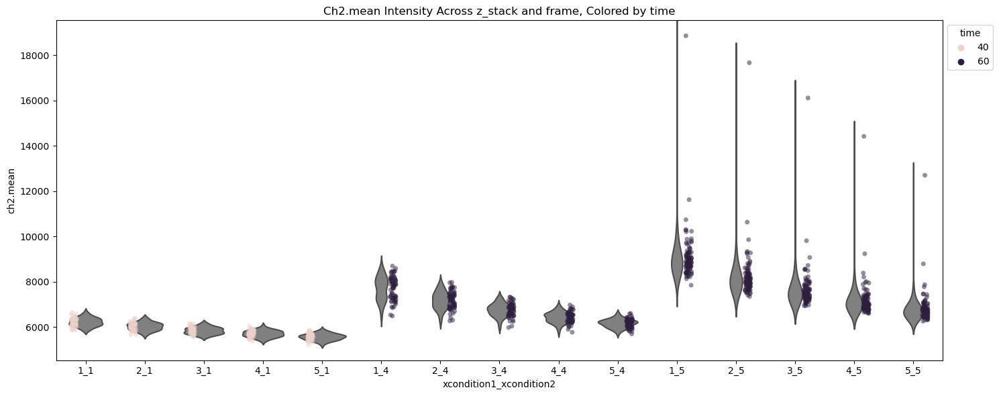

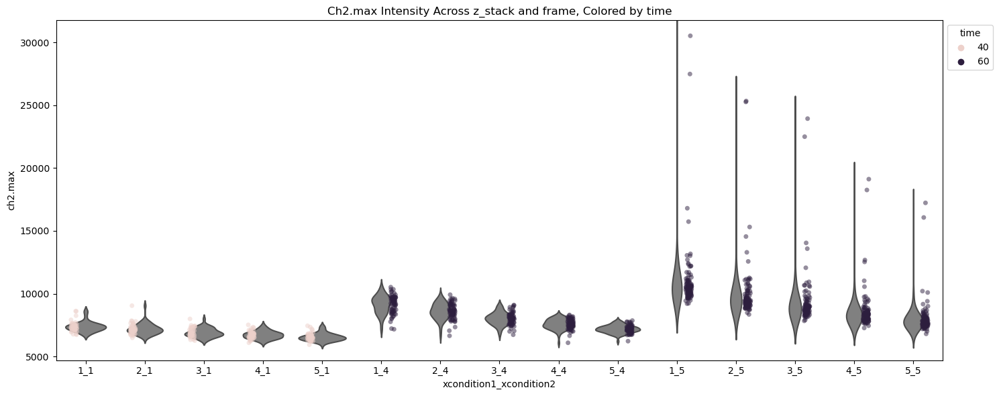

In [31]:

violin_strplot_twoconditionx_hue(df_processed, 'ch2.mean', 'z_stack', 'frame', 'time')
violin_strplot_twoconditionx_hue(df_processed, 'ch2.max', 'z_stack', 'frame', 'time')

In [38]:
def create_cell_number(df):
    # Normalize the NAME.name to remove the 'B' and convert to integer for calculations
    # Assuming the format is 'B<number>'
    df['cell_id'] = df['NAME.name'].str.extract(r'b(\d+)', expand=False).astype(int, errors='ignore')

    # Calculate the new cell number, which resets for each z-stack within an image
    df['cell_number'] = df.apply(lambda x: (x['cell_id'] - ((x['z_stack'] - 1) * x['EXPERIMENT.count'])), axis=1)

    return df

# Apply the function to create the cell_number column
df_with_cell_number = create_cell_number(df_processed)
df_with_cell_number.head()  # Display the first few rows to confirm the new column



,NAME.id,NAME.name,EXPERIMENT.count,IMAGE.meta,IMAGE.name,INTENSITY.ch1,INTENSITY.ch2,INTENSITY.ch3,LOCATION,LOCATION.center,...,ch2.stdv,ch3.mean,ch3.min,ch3.max,ch3.stdv,z_stack,image_id,cell_id,cell_number,unique_identifier
0,00c36966-040e-4542-b6b9-7ab7087fc1e1,b1,44,c:1/2 z:1/5 t:2/13 - 2023.08.01_LZ22225_40min_...,2023.08.01_LZ22225_40min_1e-1_inf.001.tif - T=1,Stats[mean=7114.5537 min=5444.0 max=11039.0 st...,Stats[mean=6361.7153 min=5142.0 max=7464.0 std...,NaN,(x=1.41 y=1.40),False,...,472.99173,NaN,NaN,NaN,NaN,1,2023.08.,1,1,2023.08._Z1_B1
1,a664994b-2be1-4102-92b6-631d95d6871e,b2,44,c:1/2 z:1/5 t:2/13 - 2023.08.01_LZ22225_40min_...,2023.08.01_LZ22225_40min_1e-1_inf.001.tif - T=1,Stats[mean=6775.1147 min=5227.0 max=10447.0 st...,Stats[mean=5991.5493 min=4870.0 max=7007.0 std...,NaN,(x=36.38 y=2.62),False,...,457.17920,NaN,NaN,NaN,NaN,1,2023.08.,2,2,2023.08._Z1_B2
2,45f66c58-3ce0-4e8d-90c6-82f275acbc5b,b3,44,c:1/2 z:1/5 t:2/13 - 2023.08.01_LZ22225_40min_...,2023.08.01_LZ22225_40min_1e-1_inf.001.tif - T=1,Stats[mean=7537.504 min=5493.0 max=10682.0 std...,Stats[mean=6633.752 min=5416.0 max=8613.0 stdv...,NaN,(x=1.70 y=2.37),False,...,601.23130,NaN,NaN,NaN,NaN,1,2023.08.,3,3,2023.08._Z1_B3
3,5085bed9-b199-4fd4-bc94-025f343211cc,b4,44,c:1/2 z:1/5 t:2/13 - 2023.08.01_LZ22225_40min_...,2023.08.01_LZ22225_40min_1e-1_inf.001.tif - T=1,Stats[mean=6690.022 min=5223.0 max=8959.0 stdv...,Stats[mean=6029.196 min=5047.0 max=7126.0 stdv...,NaN,(x=33.75 y=2.01),False,...,483.12400,NaN,NaN,NaN,NaN,1,2023.08.,4,4,2023.08._Z1_B4
4,5672b524-b882-4c89-aafd-9f6b74b179b4,b5,44,c:1/2 z:1/5 t:2/13 - 2023.08.01_LZ22225_40min_...,2023.08.01_LZ22225_40min_1e-1_inf.001.tif - T=1,Stats[mean=6243.7715 min=5090.0 max=8689.0 std...,Stats[mean=6067.4287 min=4717.0 max=7491.0 std...,NaN,(x=32.08 y=2.92),False,...,478.43182,NaN,NaN,NaN,NaN,1,2023.08.,5,5,2023.08._Z1_B5


In [ ]:
# Extend the function to loop through the specified metrics and create plots for each
def violin_strip_plot_metrics(df, metrics, xcondition1, xcondition2, huecondition):
    # Separate the plots by 'signal' using a loop
    signals = df[huecondition].unique()
    
    # Loop through each metric
    for metric in metrics:
        for signal in signals:
            df_signal = df[df[huecondition] == signal]
            
            # Create a new combined condition column for plotting
            df_signal['xcondition1_xcondition2'] = df_signal[xcondition1].astype(str) + "_" + df_signal[xcondition2].astype(str)

            plt.figure(figsize=(15, 6))
            
            # Create the violin plot
            sns.violinplot(x='xcondition1_xcondition2', y=metric, data=df_signal, inner=None, dodge=True, color='gray', alpha=0.5)
            
            # Create the strip plot
            sns.stripplot(x='xcondition1_xcondition2', y=metric, data=df_signal, hue=xcondition2, dodge=True, jitter=True, marker='o', alpha=0.5)
            
            plt.title(f'{metric.capitalize()} Intensity Across {xcondition1} and {xcondition2}, Colored by {xcondition2} - Signal: {signal}')
            plt.legend(title=xcondition2, bbox_to_anchor=(1, 1), loc=2)
            plt.tight_layout()
            plt.show()

# Define the metrics to loop through
metrics = ['mean', 'max', 'std_dev']

# Create the plots for each metric
violin_strip_plot_metrics(new_df, metrics, xcondition1, xcondition2, huecondition)
